# メディア展開データの分布を見る

## 準備

### Import

In [1]:
# warningsモジュールのインポート
import warnings

# データ解析や機械学習のライブラリ使用時の警告を非表示にする目的で警告を無視
# 本書の文脈では、可視化の学習に議論を集中させるために選択した
# ただし、学習以外の場面で、警告を無視する設定は推奨しない
warnings.filterwarnings("ignore")

In [2]:
# pathlibモジュールのインポート
# ファイルシステムのパスを扱う
from pathlib import Path

# typingモジュールからの型ヒント関連のインポート
# 関数やクラスの引数・返り値の型を注釈するためのツール
from typing import Any, Dict, List, Optional, Union

# numpy：数値計算ライブラリのインポート
# npという名前で参照可能
import numpy as np

# pandas：データ解析ライブラリのインポート
# pdという名前で参照可能
import pandas as pd

# plotly.expressのインポート
# インタラクティブなグラフ作成のライブラリ
# pxという名前で参照可能
import plotly.express as px

# plotly.figure_factoryのインポート
# 高度なプロットとデータ可視化のためのユーティリティ
# ffという名前で参照可能
import plotly.figure_factory as ff

# plotly.graph_objectsのインポート
# より詳細なグラフ作成機能を利用可能
# goという名前で参照可能
import plotly.graph_objects as go

# plotly.graph_objectsからFigureクラスのインポート
# 型ヒントの利用を主目的とする
from plotly.graph_objects import Figure

# plotly.subplotsからmake_subplotsのインポート
# 複数のサブプロットを含む複合的な図を作成する際に使用
from plotly.subplots import make_subplots

### 変数

In [5]:
# メディア展開データが保存されているディレクトリのパス
DIR_IN = Path("../../../data/mix/input/")

# 分析結果の出力先ディレクトリのパス
DIR_OUT = (
    DIR_IN.parent / "output" / Path.cwd().parts[-2] / Path.cwd().parts[-1] / "dists"
)

In [6]:
# 読み込み対象ファイル名の定義

# アニメ各話と原作マンガの作者の対応関係に関するファイル
FN_AE_CRT = "mix_ae_crt.csv"

# マンガ各話とアニメ作品の対応関係に関するファイル
FN_CE_AC = "mix_ce_ac.csv"

In [7]:
# plotlyの描画設定の定義

# plotlyのグラフ描画用レンダラーの定義
# Jupyter Notebook環境のグラフ表示に適切なものを選択
RENDERER = "plotly_mimetype+notebook"

In [8]:
# 質的変数の描画用のカラースケールの定義

# Okabe and Ito (2008)基準のカラーパレット
# 色の識別性が高く、多様な色覚の人々にも見やすい色組み合わせ
# 参考URL: https://jfly.uni-koeln.de/color/#pallet
OKABE_ITO = [
    "#000000",  # 黒 (Black)
    "#E69F00",  # 橙 (Orange)
    "#56B4E9",  # 薄青 (Sky Blue)
    "#009E73",  # 青緑 (Bluish Green)
    "#F0E442",  # 黄色 (Yellow)
    "#0072B2",  # 青 (Blue)
    "#D55E00",  # 赤紫 (Vermilion)
    "#CC79A7",  # 紫 (Reddish Purple)
]

### 関数

In [9]:
def show_fig(fig: Figure) -> None:
    """
    所定のレンダラーを用いてplotlyの図を表示
    Jupyter Bookなどの環境での正確な表示を目的とする

    Parameters
    ----------
    fig : Figure
        表示対象のplotly図

    Returns
    -------
    None
    """

    # 図の周囲の余白を設定
    # t: 上余白
    # l: 左余白
    # r: 右余白
    # b: 下余白
    fig.update_layout(margin=dict(t=25, l=25, r=25, b=25))

    # 所定のレンダラーで図を表示
    fig.show(renderer=RENDERER)

In [10]:
def create_distplot(
    df: pd.DataFrame,
    x: str,
    color: str = None,
    show_hist: bool = False,
    show_rug: bool = False,
    **kwargs: Any
) -> Figure:
    """
    データフレームから密度プロットとヒストグラムを作成する

    Parameters
    ----------
    df : pd.DataFrame
        プロットするデータを含むデータフレーム
    x : str
        密度プロットの描画対象とするカラム名
    color : str, optional
        データを分割する基準とするカラム名、指定しない場合はx列の全データを用いる
    show_hist : bool, optional
        ヒストグラムを表示するか否か、デフォルトはFalse
    show_rug : bool, optional
        ラグプロットを表示するか否か、デフォルトはFalse
    **kwargs
        ff.create_distplotに渡すその他のキーワード引数

    Returns
    -------
    Figure
        作成されたプロットのFigureオブジェクト
    """

    if color:
        # colorカラムの値でデータをグループ分け
        grouped = df.groupby(color)

        # 各グループのxカラムのデータをリストに格納、可視化用に逆順に並び替え
        hist_data = [group[x].values for _, group in grouped][::-1]

        # 各グループの名前（colorカラムの値）をラベルとしてリストに格納、可視化用に逆順に並び替え
        labels = [str(name) for name, _ in grouped][::-1]

        # 密度プロットとヒストグラムを作成
        fig = ff.create_distplot(
            hist_data, labels, show_hist=show_hist, show_rug=show_rug, **kwargs
        )
    else:
        # colorが指定されていない場合はx列の全データを用いる
        hist_data = [df[x].values]

        # 密度プロットを作成（ラベルはxを指定）
        fig = ff.create_distplot(
            hist_data,
            group_labels=[x],
            show_hist=show_hist,
            show_rug=show_rug,
            **kwargs
        )

    # x軸のタイトルをxに変更
    fig.update_xaxes(title=x)

    # y軸のタイトルを"確率密度"に変更
    fig.update_yaxes(title="確率密度")

    # 作成されたプロットを返す
    return fig

In [11]:
def format_cols(df: pd.DataFrame, cols_rename: Dict[str, str]) -> pd.DataFrame:
    """
    指定されたカラムのみをデータフレームから抽出し、カラム名をリネームする関数

    Parameters
    ----------
    df : pd.DataFrame
        入力データフレーム
    cols_rename : Dict[str, str]
        リネームしたいカラム名のマッピング（元のカラム名: 新しいカラム名）

    Returns
    -------
    pd.DataFrame
        カラムが抽出・リネームされたデータフレーム
    """

    # 指定されたカラムのみを抽出し、リネーム
    df = df[cols_rename.keys()].rename(columns=cols_rename)

    return df

In [12]:
def save_df_to_csv(df: pd.DataFrame, dir_save: Path, fn_save: str) -> None:
    """
    DataFrameをCSVファイルとして指定されたディレクトリに保存する関数

    Parameters
    ----------
    df : pd.DataFrame
        保存対象となるDataFrame
    dir_save : Path
        出力先ディレクトリのパス
    fn_save : str
        保存するCSVファイルの名前（拡張子は含めない）
    """
    # 出力先ディレクトリが存在しない場合は作成
    dir_save.mkdir(parents=True, exist_ok=True)

    # 出力先のパスを作成
    p_save = dir_save / f"{fn_save}.csv"

    # DataFrameをCSVファイルとして保存する
    df.to_csv(p_save, index=False, encoding="utf-8-sig")

    # 保存完了のメッセージを表示する
    print(f"DataFrame is saved as '{p_save}'.")

## 可視化例

In [14]:
# pandasのread_csv関数でCSVファイルの読み込み
df_ce_ac = pd.read_csv(DIR_IN / FN_CE_AC)

(mix-hist)=
### ヒストグラム

In [15]:
# 連載マンガ作品として扱う最小のマンガ各話数を、マンガデータの基礎分析を踏まえ設定
min_nce = 8

# df_ce_acを日付とceidでソートし、各ccidについて最初のmin_nce件のデータを取り出す
df_hist = (
    df_ce_ac.sort_values(["date", "ceid"], ignore_index=True)
    .groupby("ccid")
    .head(min_nce)
)

# n_ceがmin_nceのデータのみを抽出
df_hist = df_hist[df_hist["n_ce"] >= min_nce].reset_index(drop=True)

# アニメ化されたか否かを表す列を追加
df_hist["animation"] = ~df_hist["acid"].isna()
# アニメ化されたか否かとマンガ作品IDでソート
df_hist = df_hist.sort_values(["animation", "ccid"], ignore_index=True)

# 可視化用に列名を変更
cols_hist = {
    "ccid": "マンガ作品ID",
    "ceid": "マンガ各話ID",
    "date": "掲載日",
    "page_start_position": "掲載位置",
    "animation": "アニメ化",
    "mcname": "マンガ雑誌名",
}
df_hist = format_cols(df_hist, cols_hist)

In [16]:
# 可視化対象のDataFrameを確認
df_hist.head()

,マンガ作品ID,マンガ各話ID,掲載日,掲載位置,アニメ化,マンガ雑誌名
0,C109295,CE71082,1980-08-18,0.015291,False,週刊少年ジャンプ
1,C109295,CE71068,1980-08-25,0.198777,False,週刊少年ジャンプ
2,C109295,CE71051,1980-09-01,0.266055,False,週刊少年ジャンプ
3,C109295,CE71038,1980-09-08,0.394495,False,週刊少年ジャンプ
4,C109295,CE71019,1980-09-15,0.266055,False,週刊少年ジャンプ


In [17]:
# 可視化対象DataFrameを保存
save_df_to_csv(df_hist, DIR_OUT, "hist")

DataFrame is saved as '../../../data/mix/output/vol2/06/dists/hist.csv'.


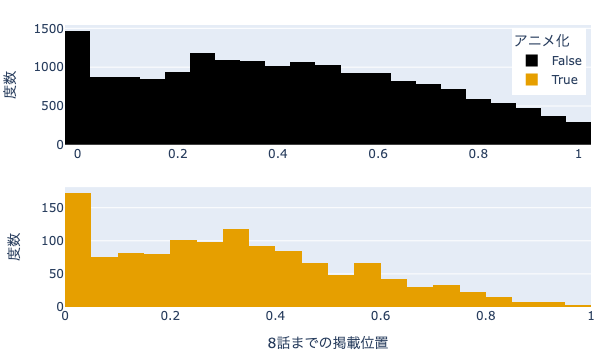

In [18]:
# ヒストグラムのビンの数を設定
nbinsx = 20

# 2行1列のサブプロットを作成
fig = make_subplots(rows=2, cols=1)

# df_histデータフレームを「アニメ化」の値でグループ化し、各グループに対して処理を実行
for i, (label, df_subplot) in enumerate(df_hist.groupby("アニメ化")):
    # OKABE_ITOカラーパレットから色を選択
    color = OKABE_ITO[i % len(OKABE_ITO)]
    # ヒストグラムを追加
    # X軸として掲載位置を指定し、ビンの数、ラベル名、色を指定
    # i+1行目にサブプロットが配置されるように調整
    fig.add_trace(
        go.Histogram(
            x=df_subplot["掲載位置"], nbinsx=nbinsx, name=label, marker={"color": color}
        ),
        row=i + 1,
        col=1,
    )

# x軸のタイトルを更新（2行目のサブプロットにのみ適用）
fig.update_xaxes(title_text=f"{min_nce}話までの掲載位置", row=2, col=1)
# y軸のタイトルを設定
fig.update_yaxes(title_text="度数")

# レイアウトの更新（凡例のタイトルと位置を設定）
fig.update_layout(
    legend_title_text="アニメ化",
    legend={"yanchor": "top", "y": 0.99, "xanchor": "right", "x": 0.99},
)

# 作成した図を表示
show_fig(fig)

In [19]:
# df_ce_acを日付とceidでソートし、各ccidについて最初のmin_nce件のデータを取り出す
df_hist2 = (
    df_ce_ac.sort_values(["date", "ceid"], ignore_index=True)
    .groupby("ccid")
    .head(min_nce)
)

# n_ceがmin_nceのデータのみを抽出
df_hist2 = df_hist2[
    (df_hist2["n_ce"] >= min_nce)
    & (pd.to_datetime(df_hist2["first_date_cc"]).dt.year >= 1990)
].reset_index(drop=True)

# アニメ化されたか否かを表す列を追加
df_hist2["animation"] = ~df_hist2["acid"].isna()
# アニメ化されたか否かとマンガ作品IDでソート
df_hist2 = df_hist2.sort_values(["animation", "ccid"], ignore_index=True)

# 可視化用に列名を変更
cols_hist2 = {
    "ccid": "マンガ作品ID",
    "ceid": "マンガ各話ID",
    "date": "掲載日",
    "page_start_position": "掲載位置",
    "animation": "アニメ化",
    "mcname": "マンガ雑誌名",
}
df_hist2 = format_cols(df_hist2, cols_hist2)

In [20]:
# 可視化対象のDataFrameを確認
df_hist2.head()

,マンガ作品ID,マンガ各話ID,掲載日,掲載位置,アニメ化,マンガ雑誌名
0,C110892,CE177364,2014-08-04,0.006000,False,週刊少年ジャンプ
1,C110892,CE177390,2014-08-11,0.180162,False,週刊少年ジャンプ
2,C110892,CE177415,2014-08-18,0.331301,False,週刊少年ジャンプ
3,C110892,CE177435,2014-09-01,0.234000,False,週刊少年ジャンプ
4,C110892,CE177471,2014-09-08,0.696429,False,週刊少年ジャンプ


In [21]:
# 可視化対象DataFrameを保存
save_df_to_csv(df_hist2, DIR_OUT, "hist2")

DataFrame is saved as '../../../data/mix/output/vol2/06/dists/hist2.csv'.


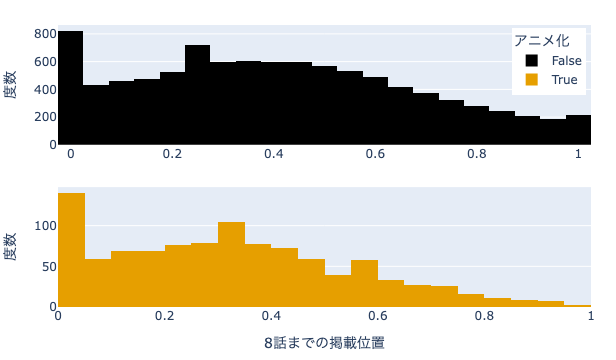

In [22]:
# ヒストグラムのビンの数を設定
nbinsx = 20

# 2行1列のサブプロットを作成
fig = make_subplots(rows=2, cols=1)

# df_histデータフレームを「アニメ化」の値でグループ化し、各グループに対して処理を実行
for i, (label, df_subplot) in enumerate(df_hist2.groupby("アニメ化")):
    # OKABE_ITOカラーパレットから色を選択
    color = OKABE_ITO[i % len(OKABE_ITO)]
    # ヒストグラムを追加
    # X軸として掲載位置を指定し、ビンの数、ラベル名、色を指定
    # i+1行目にサブプロットが配置されるように調整
    fig.add_trace(
        go.Histogram(
            x=df_subplot["掲載位置"], nbinsx=nbinsx, name=label, marker={"color": color}
        ),
        row=i + 1,
        col=1,
    )

# x軸のタイトルを更新（2行目のサブプロットにのみ適用）
fig.update_xaxes(title_text=f"{min_nce}話までの掲載位置", row=2, col=1)
# y軸のタイトルを設定
fig.update_yaxes(title_text="度数")

# レイアウトの更新（凡例のタイトルと位置を設定）
fig.update_layout(
    legend_title_text="アニメ化",
    legend={"yanchor": "top", "y": 0.99, "xanchor": "right", "x": 0.99},
)

# 作成した図を表示
show_fig(fig)

(mix-dist)=
### 密度プロット

In [23]:
# ヒストグラムと同様のデータを利用
df_dist = df_hist2.copy()

In [24]:
# 可視化対象DataFrameを保存
save_df_to_csv(df_dist, DIR_OUT, "dist")

DataFrame is saved as '../../../data/mix/output/vol2/06/dists/dist.csv'.


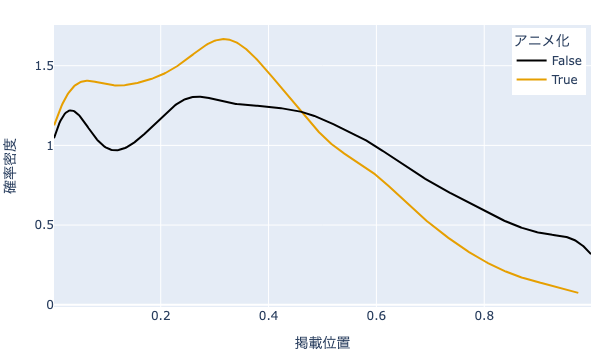

In [25]:
# df_distデータフレームを使用して密度プロットを作成
# "掲載位置"をx軸に、"アニメ化"を色分けの基準にしてプロット
# 色はOKABE_ITOスタイルで指定（ヒストグラムと配色を統一するため逆順に変更）
fig = create_distplot(
    df_dist, x="掲載位置", color="アニメ化", colors=OKABE_ITO[:2][::-1]
)

# グラフのレイアウトを更新
# ホバーモードを"x unified"に設定して、x軸に沿った統一されたホバー情報を表示
# 凡例をグラフの右上に配置（yanchorとxanchorで位置調整）
fig.update_layout(
    hovermode="x unified",
    legend=dict(title="アニメ化", yanchor="top", y=0.99, xanchor="right", x=0.99),
)

# 作成したグラフを表示
show_fig(fig)

In [26]:
# マンガ雑誌名をソートして取得
mcnames = sorted(df_dist["マンガ雑誌名"].unique())

# サブプロットを配置するための行数を取得
rows = len(mcnames)

# y軸の最大値を格納するためのリストを初期化
y_max_values = []

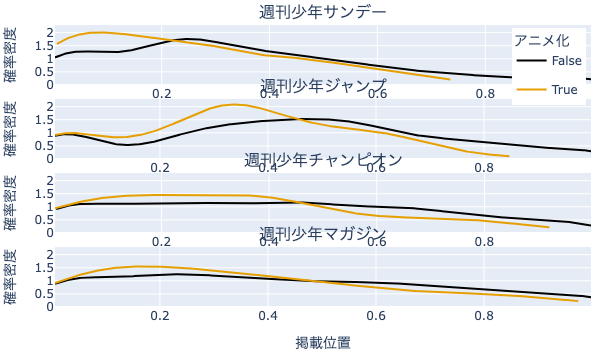

In [27]:
# 各マンガ雑誌名をタイトルとして設定し、複数のサブプロットを作成
# vertical_spacingで縦方向のファセット間の余白を調整
fig = make_subplots(rows=rows, cols=1, vertical_spacing=0.05, subplot_titles=mcnames)

# マンガ雑誌名の数だけ繰り返し処理
for i, mcname in enumerate(mcnames):
    # 現在のマンガ雑誌名に対応するデータをフィルタリング
    df_mc = df_dist[df_dist["マンガ雑誌名"] == mcname].sort_values(
        "アニメ化", ignore_index=True
    )
    # 掲載位置の密度プロットを作成
    distplot = create_distplot(
        df_mc, x="掲載位置", color="アニメ化", colors=OKABE_ITO[:2][::-1]
    )

    # 各サブプロットのy軸の最大値をリストに追加
    y_max_values.append(np.max([trace.y for trace in distplot.data]))

    # 作成した密度プロットを図に追加、可視化のために逆順でtraceを追加
    for trace in distplot.data[::-1]:
        # 凡例が重複しないよう、i==0のときのみ一つだけ表示
        if i > 0:
            trace.showlegend = False
        fig.add_trace(trace, row=i + 1, col=1)

# 全サブプロットの中で最大のy軸値を計算
y_max = np.max(y_max_values)

# Y軸のラベルを表示し、表示範囲を最大値の1.1倍に調整
fig.update_yaxes(title_text="確率密度", range=[0, y_max * 1.1])
# X軸のラベルを下側のサブプロットのみに表示
fig.update_xaxes(title_text="掲載位置", row=rows, col=1)

# ホバーモードを"x unified"に設定して、x軸に沿った統一されたホバー情報を表示
# 各密度プロットが潰れてしまわないように、heightで高さを調整
fig.update_layout(
    hovermode="x unified",
    height=800,
    legend=dict(title="アニメ化", yanchor="top", y=0.99, xanchor="right", x=0.99),
)

# 作成した図を表示する
show_fig(fig)

(mix-box)=
### 箱ひげ図

In [28]:
# 密度プロットと同じデータを利用
df_box = df_dist.copy()
# マンガ雑誌名とアニメ化有無でソート
df_box = df_box.sort_values(["マンガ雑誌名", "アニメ化"], ignore_index=True)

In [29]:
# 可視化対象DataFrameを保存
save_df_to_csv(df_box, DIR_OUT, "box")

DataFrame is saved as '../../../data/mix/output/vol2/06/dists/box.csv'.


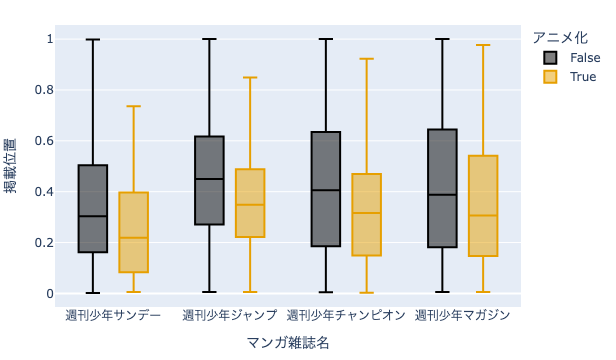

In [30]:
# Plotly Expressを使用して箱ひげ図を作成
# df_boxデータフレームを使い、x軸に"マンガ雑誌名"、y軸に"掲載位置"を設定
# "アニメ化"の値によって色分けし、色の配列としてOKABE_ITOの最初の2色を使用
fig = px.box(
    df_box,
    x="マンガ雑誌名",
    y="掲載位置",
    color="アニメ化",
    color_discrete_sequence=OKABE_ITO[:2],
)

# 作成した図を表示
show_fig(fig)

(mix-vio)=
### バイオリンプロット

In [31]:
# 箱ひげ図と同様のデータを利用
df_vio = df_box.copy()

In [32]:
# 可視化対象DataFrameを保存
save_df_to_csv(df_vio, DIR_OUT, "vio")

DataFrame is saved as '../../../data/mix/output/vol2/06/dists/vio.csv'.


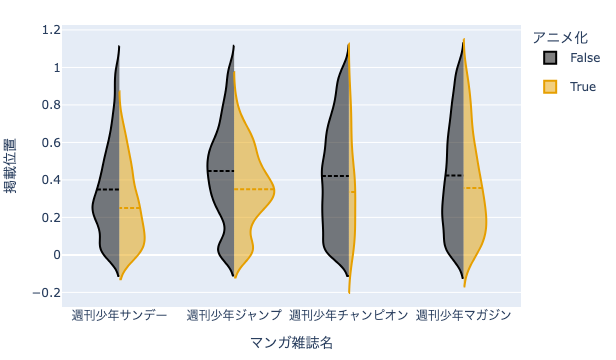

In [33]:
# 空のFigureオブジェクトを作成
fig = go.Figure()

# アニメ化されていない作品（アニメ化=False）のバイオリンプロットを追加
# 'マンガ雑誌名'をx軸に、'掲載位置'をy軸に設定し、左側（negative side）にプロット
fig.add_trace(
    go.Violin(
        x=df_vio[~df_vio["アニメ化"]]["マンガ雑誌名"],
        y=df_vio[~df_vio["アニメ化"]]["掲載位置"],
        legendgroup="False",  # 凡例のグループを設定
        scalegroup="False",  # スケールグループを設定
        name="False",  # 凡例の名前
        side="negative",  # プロットの側面を指定
        line_color=OKABE_ITO[0],  # 線の色を指定
    )
)

# アニメ化された作品（アニメ化=True）のバイオリンプロットを追加
# 'マンガ雑誌名'をx軸に、'掲載位置'をy軸に設定し、右側（positive side）にプロット
fig.add_trace(
    go.Violin(
        x=df_vio[df_vio["アニメ化"]]["マンガ雑誌名"],
        y=df_vio[df_vio["アニメ化"]]["掲載位置"],
        legendgroup="True",  # 凡例のグループを設定
        scalegroup="True",  # スケールグループを設定
        name="True",  # 凡例の名前
        side="positive",  # プロットの側面を指定
        line_color=OKABE_ITO[1],  # 線の色を指定
    )
)

# バイオリンプロットの設定を更新
# 平均線を表示し、バイオリンの幅をデータの個数に応じてスケーリング
fig.update_traces(meanline_visible=True, scalemode="count")

# レイアウトを更新してバイオリンの間隔、オーバーレイモードを設定し、凡例のタイトルを追加
fig.update_layout(violingap=0, violinmode="overlay", legend={"title": "アニメ化"})

# x軸とy軸のタイトルを更新し、x軸の範囲を設定
fig.update_xaxes(title="マンガ雑誌名", range=[-0.5, 3.5])
fig.update_yaxes(title="掲載位置")

# 作成した図を表示
show_fig(fig)

(mix-ridge)=
### リッジラインプロット

In [34]:
# ヒストグラムで用いたものと同じデータを使用
df_ridge = df_hist2.copy()

In [35]:
# データをccidとdateでソートしておく
df_ridge = df_ridge.sort_values(["マンガ作品ID", "掲載日"], ignore_index=True)

# cumcountメソッドを用いて各マンガ作品名ごとに話数インデックス（ceno）を振る
df_ridge["話数"] = df_ridge.groupby("マンガ作品ID").cumcount() + 1

In [36]:
# データフレームからユニークな話数を取得
cenos = sorted(df_ridge["話数"].unique())

# サブプロットを配置するための行数を計算
rows = len(cenos)

# y軸の最大値を格納するためのリストを初期化
y_max_values = []

In [37]:
# 可視化対象のDataFrameを確認
df_ridge.head()

,マンガ作品ID,マンガ各話ID,掲載日,掲載位置,アニメ化,マンガ雑誌名,話数
0,C110892,CE177364,2014-08-04,0.006000,False,週刊少年ジャンプ,1
1,C110892,CE177390,2014-08-11,0.180162,False,週刊少年ジャンプ,2
2,C110892,CE177415,2014-08-18,0.331301,False,週刊少年ジャンプ,3
3,C110892,CE177435,2014-09-01,0.234000,False,週刊少年ジャンプ,4
4,C110892,CE177471,2014-09-08,0.696429,False,週刊少年ジャンプ,5


In [38]:
# 可視化対象DataFrameを保存
save_df_to_csv(df_ridge, DIR_OUT, "ridge")

DataFrame is saved as '../../../data/mix/output/vol2/06/dists/ridge.csv'.


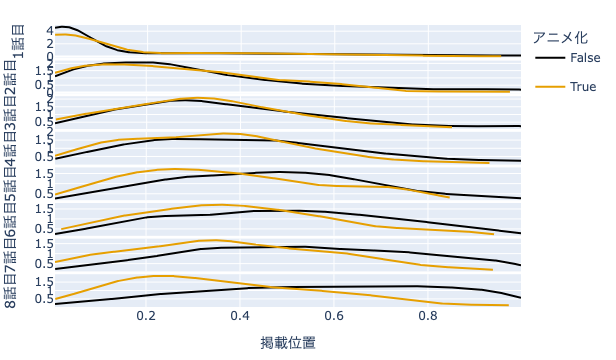

In [39]:
# 複数のサブプロットを持つ図を作成。各話数をサブプロットのタイトルとして設定
# vertical_spacingで縦方向のファセット間の余白を調整
fig = make_subplots(rows=rows, cols=1, vertical_spacing=0.01)

# 話数の数だけ繰り返し処理
for i, ceno in enumerate(cenos):
    # 現在の話数に対応するデータをフィルタリング
    df_ceno = df_ridge[df_ridge["話数"] == ceno].sort_values(
        "アニメ化", ignore_index=True
    )
    # 掲載位置の密度プロットを作成
    distplot = create_distplot(
        df_ceno, x="掲載位置", color="アニメ化", colors=OKABE_ITO[:2][::-1]
    )

    # 作成した密度プロットを図に追加、可視化のために逆順でtraceを追加
    for trace in distplot.data[::-1]:
        # 凡例が重複しないよう、i==0のときのみ一つだけ表示
        if i > 0:
            trace.showlegend = False
        fig.add_trace(trace, row=i + 1, col=1)

    # Y軸のラベルとして話数を表示
    fig.update_yaxes(title_text=f"{ceno}話目", row=i + 1)
    # X軸のメモリを表示しないように設定
    fig.update_xaxes(showticklabels=False, row=i + 1)

# X軸のラベルを下側のサブプロットのみに表示
fig.update_xaxes(title_text="掲載位置", showticklabels=True, row=rows)

# ホバーモードを"x unified"に設定して、x軸に沿った統一されたホバー情報を表示
# 各密度プロットが潰れてしまわないように、heightで高さを調整
fig.update_layout(hovermode="x unified", height=800, legend={"title": "アニメ化"})

# 作成した図を表示する
show_fig(fig)